# Valorant Agent Stats for the Pearl Map (as of August 2023)
# Valorant Agent Stats in Pearl Map

## Introduction

In the ever-evolving landscape of competitive gaming, **Valorant** has established itself as a prominent player in the first-person shooter genre. Combining tactical gameplay with unique agent abilities, Valorant offers a dynamic experience that keeps players engaged and strategizing every step of the way. As a passionate data analyst and avid Valorant player, I embarked on a journey to unravel the secrets behind agent performance on the "Pearl" map. Through meticulous data collection and thorough analysis, I aimed to shed light on the strategies, strengths, and weaknesses that define top-performing agents in this intriguing virtual battleground.

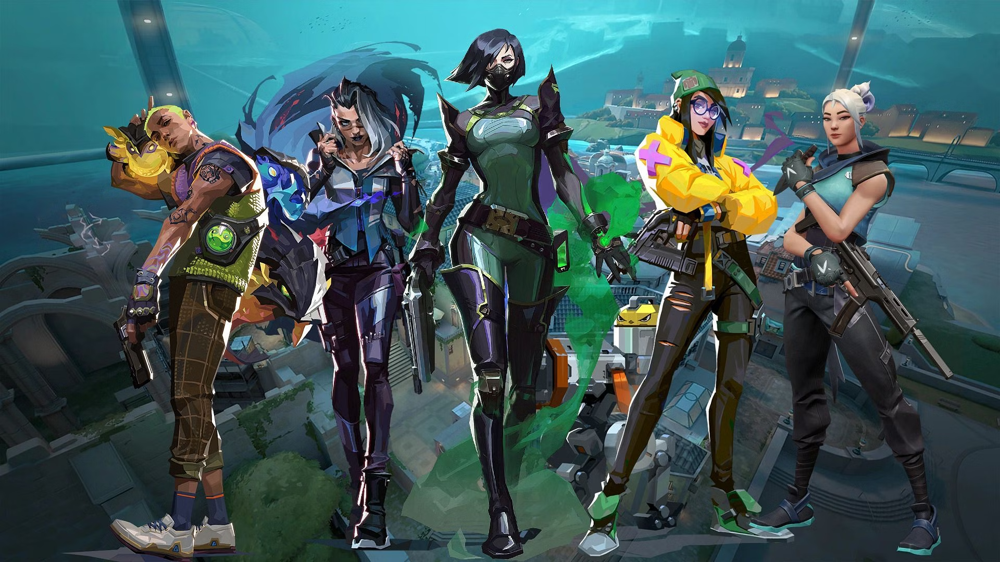

## Exploring Pearl: A Unique Battleground

"**Pearl**" is a captivating map in the Valorant universe that offers a distinctive setting for intense battles. Set in a stunning coastal location, Pearl provides a visual treat with its combination of architectural marvels and natural elements. The map's layout challenges players to adapt their strategies, as it presents a mix of open areas and tight corridors. With its unique visual design and strategic nuances, Pearl sets the stage for engaging gameplay that tests the skills of even the most seasoned players.

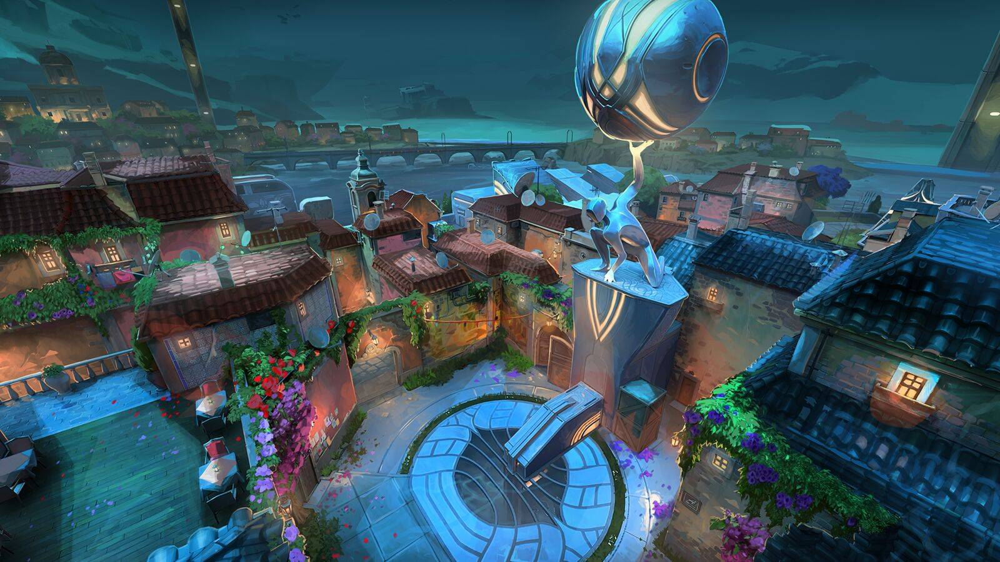

## Project Goals

Throughout my data analysis journey, I pursued several key goals that would enable me to gain meaningful insights into agent performance on the Pearl map:

1. **Comprehensive Agent Performance Assessment:** My primary goal was to meticulously assess the performance of each agent on the Pearl map. By analyzing critical metrics such as Kill-Death Ratio (KD), Kill-Death-Assist Ratio (KDA), Win Percentage, and Average Score, I aimed to identify patterns that differentiate successful agents from their counterparts. This analysis would provide a holistic view of agent viability on this unique battleground.

2. **Uncovering Strategic Trends:** I delved deep into the data to uncover trends and strategies that successful players and agents employ on the Pearl map. By examining pick percentages and win rates, I aimed to pinpoint agents that excel in certain scenarios or offer a competitive advantage based on their abilities and playstyles.

3. **Spotlight on Agent Abilities:** Valorant is renowned for its agents' unique abilities, and my analysis wouldn't be complete without assessing the impact of these abilities on the Pearl map. I meticulously examined how agents with diverse abilities contribute to team success, utilizing data on First Blood percentages and Average Scores to understand their influence in key moments.

4. **Providing Strategic Insights:** Armed with a deep understanding of agent performance and strategies on the Pearl map, I aimed to provide fellow players with strategic insights that would empower them to make informed decisions. Whether it's selecting the most suitable agent for a particular situation or adapting strategies based on statistical evidence, my analysis aimed to enhance the strategic landscape of Valorant gameplay on Pearl.

Through this data analysis project, I've unearthed valuable insights that not only enhance my own gameplay but also contribute to the wider Valorant community's understanding of agent dynamics on the Pearl map.


## Imported Packages

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

## Imported Data

In [3]:
data = pd.read_csv('/kaggle/input/valorant-agent-stats-in-pearl-map/Valorant Agent Stats in Pearl Map - Sheet1 (1).csv')
data

,agent,kd,kda,win_pcnt,pick_pcnt,avg_score,matches
0,Breach,0.97,15.8 / 16.2 / 4.5,0.321,0.020,509,1772727
1,Brimstone,0.92,13.5 / 14.7 / 5,0.367,0.038,364,3292834
2,Cypher,0.99,14.3 / 14.4 / 4.1,0.383,0.031,355,2730394
3,Jett,1.06,13.6 / 12.9 / 3.2,0.448,0.095,284,8273878
4,Omen,0.98,13.8 / 14 / 4.4,0.405,0.046,306,4030353
5,Phoenix,0.98,13.1 / 13.4 / 3.6,0.408,0.056,313,4845435
6,Raze,1.04,13.5 / 13 / 3.8,0.438,0.060,310,5203330
7,Sage,0.87,11.1 / 12.7 / 4.9,0.443,0.085,235,7425154
8,Sova,0.90,12.6 / 14 / 4,0.372,0.042,330,3681941
9,Viper,1.01,14.2 / 14.1 / 4.5,0.408,0.038,329,3272968


## Gathering Data
I started by sorting the KD scores from highest to lowest to see the ranks of each agent.

In [28]:
datakd_sorted = data.sort_values(by='kd', ascending=False)
datakd_sorted.head()

,agent,kd,kda,win_pcnt,pick_pcnt,avg_score,matches,kills_kda,deaths_kda,assists_kda
10,Reyna,1.14,14.6 / 12.7 / 3.7,0.465,0.098,290,8527042,14.6,12.7,3.7
14,Astra,1.10,16.9 / 15.3 / 4.7,0.360,0.021,474,1830393,16.9,15.3,4.7
15,Chamber,1.07,14.7 / 13.8 / 3.1,0.404,0.040,342,3452414,14.7,13.8,3.1
3,Jett,1.06,13.6 / 12.9 / 3.2,0.448,0.095,284,8273878,13.6,12.9,3.2
6,Raze,1.04,13.5 / 13 / 3.8,0.438,0.060,310,5203330,13.5,13.0,3.8


Then, I looked into the KDA of each agent. First, I created three more columns, "kills_kda", "deaths_kda", and "assists_kda". Then I sorted the new columns by descending order.

In [5]:
data.dtypes

agent         object
kd           float64
kda           object
win_pcnt     float64
pick_pcnt    float64
avg_score      int64
matches        int64
dtype: object

In [6]:
data[['kills_kda', 'deaths_kda', 'assists_kda']] = data['kda'].str.split('/', expand=True)
data.head()

,agent,kd,kda,win_pcnt,pick_pcnt,avg_score,matches,kills_kda,deaths_kda,assists_kda
0,Breach,0.97,15.8 / 16.2 / 4.5,0.321,0.020,509,1772727,15.8,16.2,4.5
1,Brimstone,0.92,13.5 / 14.7 / 5,0.367,0.038,364,3292834,13.5,14.7,5
2,Cypher,0.99,14.3 / 14.4 / 4.1,0.383,0.031,355,2730394,14.3,14.4,4.1
3,Jett,1.06,13.6 / 12.9 / 3.2,0.448,0.095,284,8273878,13.6,12.9,3.2
4,Omen,0.98,13.8 / 14 / 4.4,0.405,0.046,306,4030353,13.8,14,4.4


In [7]:
data['kills_kda'] = pd.to_numeric(data['kills_kda'])
data['deaths_kda'] = pd.to_numeric(data['deaths_kda'])
data['assists_kda'] = pd.to_numeric(data['assists_kda'])
data.dtypes

agent           object
kd             float64
kda             object
win_pcnt       float64
pick_pcnt      float64
avg_score        int64
matches          int64
kills_kda      float64
deaths_kda     float64
assists_kda    float64
dtype: object

In [30]:
data_killskda_sorted = data.sort_values(by='kills_kda', ascending=False)
data_killskda_sorted.head()

,agent,kd,kda,win_pcnt,pick_pcnt,avg_score,matches,kills_kda,deaths_kda,assists_kda
14,Astra,1.10,16.9 / 15.3 / 4.7,0.360,0.021,474,1830393,16.9,15.3,4.7
0,Breach,0.97,15.8 / 16.2 / 4.5,0.321,0.020,509,1772727,15.8,16.2,4.5
19,Harbor,0.98,15.2 / 15.6 / 4.6,0.349,0.022,413,1943814,15.2,15.6,4.6
15,Chamber,1.07,14.7 / 13.8 / 3.1,0.404,0.040,342,3452414,14.7,13.8,3.1
10,Reyna,1.14,14.6 / 12.7 / 3.7,0.465,0.098,290,8527042,14.6,12.7,3.7


In [32]:
data_deathskda_sorted = data.sort_values(by='deaths_kda', ascending=False)
data_deathskda_sorted.head()

,agent,kd,kda,win_pcnt,pick_pcnt,avg_score,matches,kills_kda,deaths_kda,assists_kda
0,Breach,0.97,15.8 / 16.2 / 4.5,0.321,0.020,509,1772727,15.8,16.2,4.5
19,Harbor,0.98,15.2 / 15.6 / 4.6,0.349,0.022,413,1943814,15.2,15.6,4.6
14,Astra,1.10,16.9 / 15.3 / 4.7,0.360,0.021,474,1830393,16.9,15.3,4.7
18,KAY/O,0.94,14.2 / 15.2 / 5.6,0.354,0.029,378,2498286,14.2,15.2,5.6
1,Brimstone,0.92,13.5 / 14.7 / 5,0.367,0.038,364,3292834,13.5,14.7,5.0


In [34]:
data_assistskda_sorted = data.sort_values(by='assists_kda', ascending=False)
data_assistskda_sorted.head()

,agent,kd,kda,win_pcnt,pick_pcnt,avg_score,matches,kills_kda,deaths_kda,assists_kda
12,Skye,0.97,13.5 / 13.9 / 5.6,0.413,0.043,309,3694821,13.5,13.9,5.6
18,KAY/O,0.94,14.2 / 15.2 / 5.6,0.354,0.029,378,2498286,14.2,15.2,5.6
1,Brimstone,0.92,13.5 / 14.7 / 5,0.367,0.038,364,3292834,13.5,14.7,5.0
17,Fade,0.96,13.8 / 14.3 / 4.9,0.398,0.036,333,3091166,13.8,14.3,4.9
7,Sage,0.87,11.1 / 12.7 / 4.9,0.443,0.085,235,7425154,11.1,12.7,4.9


After that, I sorted the win percent of each agent in descending order.

In [36]:
data_winpcnt_sorted = data.sort_values(by='win_pcnt', ascending=False)
data_winpcnt_sorted.head()

,agent,kd,kda,win_pcnt,pick_pcnt,avg_score,matches,kills_kda,deaths_kda,assists_kda
10,Reyna,1.14,14.6 / 12.7 / 3.7,0.465,0.098,290,8527042,14.6,12.7,3.7
3,Jett,1.06,13.6 / 12.9 / 3.2,0.448,0.095,284,8273878,13.6,12.9,3.2
7,Sage,0.87,11.1 / 12.7 / 4.9,0.443,0.085,235,7425154,11.1,12.7,4.9
6,Raze,1.04,13.5 / 13 / 3.8,0.438,0.060,310,5203330,13.5,13.0,3.8
21,Deadlock,1.01,13.2 / 13 / 3.3,0.431,0.042,302,3611294,13.2,13.0,3.3


Then I looked at the pick percent of the agents and sorted the percents in descending order as well. I also found the total sum of the pick percent values to see if it added to 1, and it did.

In [38]:
data_pickpcnt_sorted = data.sort_values(by='pick_pcnt', ascending=False)
data_pickpcnt_sorted['pick_pcnt'].sum()
data_pickpcnt_sorted['pick_pcnt'] = data_pickpcnt_sorted['pick_pcnt'] * 100
data_pickpcnt_sorted.head()

,agent,kd,kda,win_pcnt,pick_pcnt,avg_score,matches,kills_kda,deaths_kda,assists_kda
10,Reyna,1.14,14.6 / 12.7 / 3.7,0.465,9.8,290,8527042,14.6,12.7,3.7
3,Jett,1.06,13.6 / 12.9 / 3.2,0.448,9.5,284,8273878,13.6,12.9,3.2
7,Sage,0.87,11.1 / 12.7 / 4.9,0.443,8.5,235,7425154,11.1,12.7,4.9
6,Raze,1.04,13.5 / 13 / 3.8,0.438,6.0,310,5203330,13.5,13.0,3.8
5,Phoenix,0.98,13.1 / 13.4 / 3.6,0.408,5.6,313,4845435,13.1,13.4,3.6


I also sorted the number of matches of each agent in descending order.

In [40]:
data_matches_sorted = data.sort_values(by='matches', ascending=False)
data_matches_sorted.head()

,agent,kd,kda,win_pcnt,pick_pcnt,avg_score,matches,kills_kda,deaths_kda,assists_kda
10,Reyna,1.14,14.6 / 12.7 / 3.7,0.465,0.098,290,8527042,14.6,12.7,3.7
3,Jett,1.06,13.6 / 12.9 / 3.2,0.448,0.095,284,8273878,13.6,12.9,3.2
7,Sage,0.87,11.1 / 12.7 / 4.9,0.443,0.085,235,7425154,11.1,12.7,4.9
6,Raze,1.04,13.5 / 13 / 3.8,0.438,0.060,310,5203330,13.5,13.0,3.8
5,Phoenix,0.98,13.1 / 13.4 / 3.6,0.408,0.056,313,4845435,13.1,13.4,3.6


Lastly, I sorted the average score of each agent in descending order.

In [46]:
data_avgscore_sorted = data.sort_values(by='avg_score', ascending=False)
data_avgscore_sorted.head()

,agent,kd,kda,win_pcnt,pick_pcnt,avg_score,matches,kills_kda,deaths_kda,assists_kda
0,Breach,0.97,15.8 / 16.2 / 4.5,0.321,0.020,509,1772727,15.8,16.2,4.5
14,Astra,1.10,16.9 / 15.3 / 4.7,0.360,0.021,474,1830393,16.9,15.3,4.7
19,Harbor,0.98,15.2 / 15.6 / 4.6,0.349,0.022,413,1943814,15.2,15.6,4.6
18,KAY/O,0.94,14.2 / 15.2 / 5.6,0.354,0.029,378,2498286,14.2,15.2,5.6
1,Brimstone,0.92,13.5 / 14.7 / 5,0.367,0.038,364,3292834,13.5,14.7,5.0


## Data Visualizations of Results
### Kill-Death Scores of the Valorant Agents in Pearl

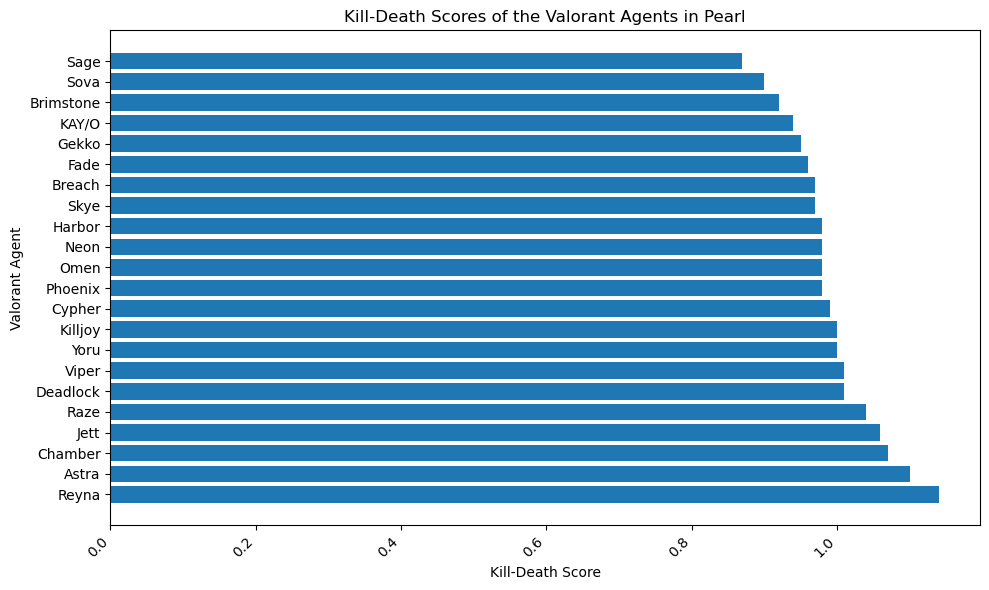

In [17]:
plt.figure(figsize=(10,6))
plt.barh(datakd_sorted['agent'], datakd_sorted['kd'])
plt.xlabel("Kill-Death Score")
plt.ylabel("Valorant Agent")
plt.title("Kill-Death Scores of the Valorant Agents in Pearl")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### FINDINGS:

**Agent Performance Analysis: Kill-Death Ratio (KD) on Pearl Map**

In my comprehensive analysis of agent performance on the Pearl map, I focused on the Kill-Death Ratio (KD) as a fundamental indicator of individual combat prowess. The KD ratio provides insights into the number of kills achieved in comparison to the number of deaths suffered, thereby highlighting an agent's efficiency in eliminating opponents while minimizing their own eliminations.

**Top Agents: Masters of Precision and Dominance**

Among the agents on the Pearl map, several notable contenders emerged with remarkable KD ratios. At the pinnacle stands **Reyna**, exhibiting an exceptional KD ratio of 1.14. This impressive ratio is emblematic of her formidable offensive capabilities, as she excels at securing eliminations and sustaining her presence in battles. The combination of Reyna's "Dismiss" ability, allowing her to phase out of danger after securing a kill, and the "Leer" ability, which blinds enemies, grants her an edge in skirmishes.

**Astra**, with a commendable KD ratio of 1.10, follows closely. Astra's strategic control over the battlefield through her star-based abilities, "Nebula" and "Gravity Well," allows her to create advantageous engagements that amplify her chances of achieving eliminations.

**Chamber**, maintaining a strong KD ratio of 1.07, showcases his adaptability and skill. His "Phase" ability provides him with the capacity to traverse the map swiftly, offering the opportunity to engage opponents on his own terms.

**Jett**, renowned for her agility and precision, boasts a KD ratio of 1.06. Her "Cloudburst" ability grants her tactical movement options, enabling her to maneuver deftly and position herself advantageously in engagements.

**Emerging Patterns: Tactical Aggression and Versatility**

A recurring theme among these top agents is their capacity for tactical aggression and adaptability. While some agents specialize in initiating confrontations, others focus on maneuverability, allowing them to engage and disengage swiftly. This diversity in agent abilities contributes to a multifaceted approach to encounters on the Pearl map.

Moreover, their KD ratios correlate with the Pearl map's architectural intricacies. The blend of open spaces and tight corridors necessitates adaptability in playstyle and an acute understanding of when to engage and when to seek cover.

-

In this data-driven exploration, I've unveiled the prowess of agents in achieving eliminations while minimizing deaths on the Pearl map. The agents with the highest KD ratios - Reyna, Astra, Chamber, and Jett - embody tactical precision, map awareness, and adaptability, making them forces to be reckoned with on this dynamic battleground. By harnessing their unique abilities and understanding the map's structure, these agents assert dominance in the pursuit of victory.


### Valorant Agent Kills from KDA in Pearl

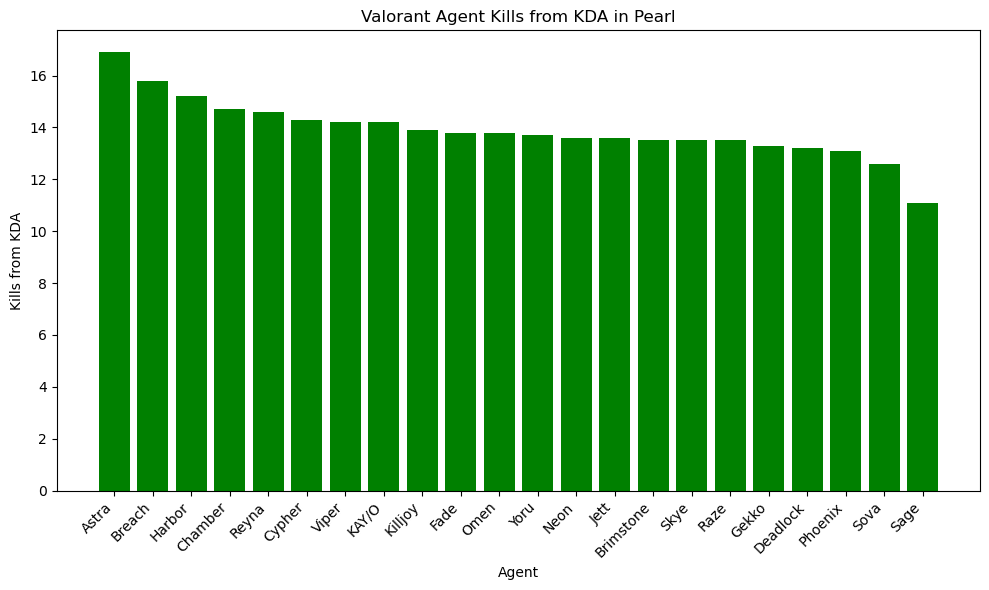

In [16]:
plt.figure(figsize=(10, 6))
plt.bar(data_killskda_sorted['agent'], data_killskda_sorted['kills_kda'], color = 'green')
plt.xlabel('Agent')
plt.ylabel('Kills from KDA')
plt.title('Valorant Agent Kills from KDA in Pearl')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

#### FINDINGS:
**Agent Performance Analysis: Kills per KDA on Pearl Map**

In this comprehensive analysis of agent performance on the Pearl map, the focus has shifted to the "kills_kda" metric, providing insights into the agents' prowess in securing eliminations within the context of their Kill-Death-Assist Ratio (KDA). This metric highlights an agent's ability to convert engagements into kills while also considering their overall contribution to the team.

**Top Agents: Mastery of Elimination and Contribution**

Among the agents on the Pearl map, a select group of contenders have emerged with exceptional "kills_kda" scores, demonstrating their capability to secure eliminations while maintaining a balanced KDA. Leading the charge are:

- **Astra**: Showcasing an outstanding "kills_kda" ratio of 16.9, Astra's celestial abilities like "Nebula" and "Gravity Well" grant her strategic control over confrontations, facilitating advantageous eliminations.

- **Breach**: Boasting a commendable "kills_kda" score of 15.8, Breach's abilities such as "Fault Line" and "Rolling Thunder" contribute to his high kills-to-KDA ratio.

- **Harbor**: Maintaining a noteworthy "kills_kda" ratio of 15.2, Harbor's tactical "Seismic Slam" ability empowers him to dominate confrontations and control critical areas effectively.

**Emerging Patterns: Precision in Strategy and Teamwork**

A recurring theme among these top agents is their ability to secure eliminations while maintaining a balanced contribution to their team's objectives. These agents excel in strategic positioning and making calculated decisions to secure kills while also supporting their team's goals.

Their performance in achieving kills while sustaining a respectable KDA aligns with the dynamic structure of the Pearl map. The fusion of open spaces and intricate pathways demands precise execution in engagements, and these agents demonstrate mastery by securing eliminations without compromising their overall contributions.

**Common Themes: Map Awareness and Versatile Abilities**

An underlying thread connecting these top agents is their profound understanding of the Pearl map's layout and intricacies. By leveraging their abilities to control sightlines, initiate ambushes, or hinder enemy movements, these agents capitalize on their map knowledge to secure eliminations efficiently.

Furthermore, their versatile abilities contribute to their remarkable "kills_kda" performance. Whether it's Astra's strategic manipulation of "Celestial" powers, Breach's disruptive capabilities, or Harbor's seismic impact, each agent's unique skill set enhances their elimination and KDA performance.

-

In this exhaustive exploration, the agents' proficiency in securing eliminations while maintaining a balanced contribution to their team's objectives on the Pearl map has been illuminated. Agents with the highest "kills_kda" scores - Astra, Breach, and Harbor - epitomize strategic precision and versatile abilities, enabling them to excel in confrontations and uphold their pivotal roles within the team dynamic. By adapting to the map's intricacies and harnessing their distinctive skills, these agents exemplify mastery over the Pearl battleground.

### Valorant Agent Deaths from KDA in Pearl

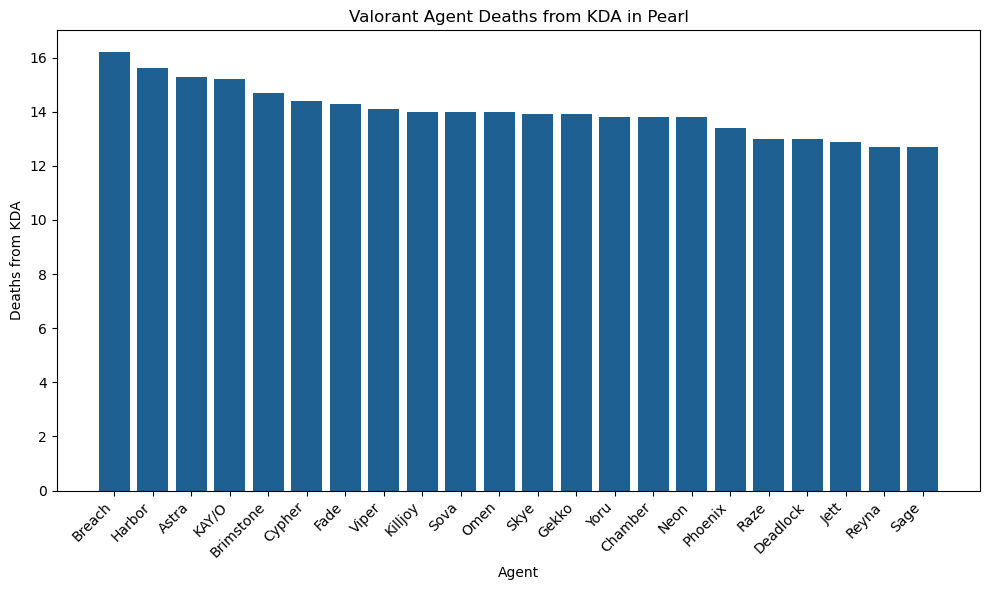

In [18]:
plt.figure(figsize=(10, 6))
plt.bar(data_deathskda_sorted['agent'], data_deathskda_sorted['deaths_kda'], color = '#1E6091')
plt.xlabel('Agent')
plt.ylabel('Deaths from KDA')
plt.title('Valorant Agent Deaths from KDA in Pearl')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### FINDINGS:
**Agent Performance Analysis: Deaths per KDA on Pearl Map**

In this examination of agent performance on the Pearl map, the focus is on the "deaths_kda" metric, which sheds light on the agents' vulnerability and tendency to die within engagements. This metric highlights agents whose KDA might be influenced by a higher number of deaths, offering insights into their ability to withstand challenges and make effective contributions while staying alive.

**Top Agents: Balancing Survival and Contribution**

Within the context of the Pearl map, certain agents stand out with elevated "deaths_kda" scores, indicating a higher tendency to die in the midst of engagements. Leading this category are:
- **Breach**, whose elevated "deaths_kda" score of 16.2 suggests a tendency to be involved in riskier situations, perhaps due to his role as an initiator with abilities like "Aftershock" and "Concussion."
- **Harbor**, with a "deaths_kda" score of 15.6, potentially showcasing his engagement in intense conflicts, likely influenced by his abilities such as "Seismic Slam" and "Flux."
- **Astra**, who maintains a "deaths_kda" ratio of 15.3, reflecting her role as a celestial controller and her strategic use of abilities like "Nova Pulse" and "Gravity Well."

**Emerging Patterns: Risk-Taking and Tactical Mastery**

A noteworthy pattern among these top agents is their tendency to be engaged in scenarios that might lead to higher deaths, while still maintaining a balanced KDA. These agents display tactical mastery and a willingness to take calculated risks, which could be driven by their roles as initiators or controllers.

This propensity to be involved in more intense confrontations aligns with the dynamic and multifaceted nature of the Pearl map. The map's layout encourages a mix of close-quarter battles and long-range engagements, influencing the agents' positioning and decision-making.

**Common Themes: Strategic Engagement and Impactful Abilities**

Despite their tendency to face higher deaths, these agents excel in strategic engagement and the use of their abilities to impact battles. Their ability to balance the risks of dying with contributing to their team's success demonstrates their deep understanding of the Pearl map's dynamics.

Breach's disruptive capabilities, Harbor's seismic control, and Astra's celestial manipulation all contribute to their impact on engagements. Despite potentially higher deaths, their strategic insights and combat prowess allow them to hold essential roles within their teams.

-

This comprehensive analysis delves into how agents' "deaths_kda" scores indicate their propensity to die more frequently within engagements on the Pearl map. Agents like Breach, Harbor, and Astra, with their higher "deaths_kda" ratios, display a willingness to take risks and engage in intense scenarios. While their higher deaths might seem concerning, it's essential to acknowledge that their roles often demand them to initiate, disrupt, or control, which inherently carries some level of risk.


### Valorant Agent Assists from KDA in Pearl

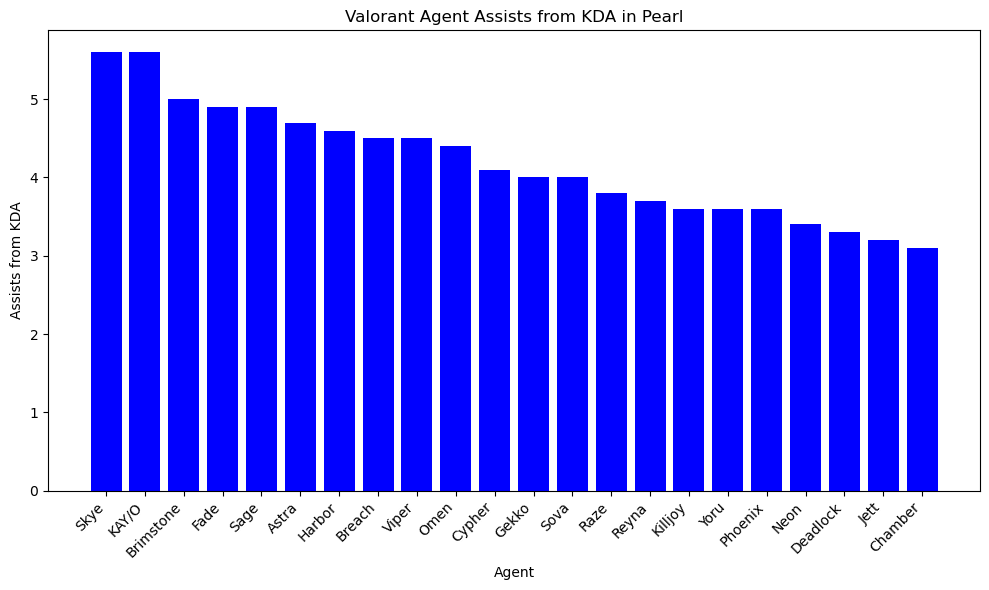

In [19]:
plt.figure(figsize=(10, 6))
plt.bar(data_assistskda_sorted['agent'], data_assistskda_sorted['assists_kda'], color = 'Blue')
plt.xlabel('Agent')
plt.ylabel('Assists from KDA')
plt.title('Valorant Agent Assists from KDA in Pearl')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### FINDINGS:
**Agent Performance Analysis: Assists per KDA on Pearl Map**

This analysis dives deep into agent performance on the Pearl map, specifically focusing on the "assists_kda" metric. This metric reveals agents' propensity to contribute to their team's success through assists, highlighting their ability to set up plays and facilitate engagements.

**Top Agents: Mastering Team Play**

Among the agents examined, those who exhibit a strong tendency towards assisting their teammates emerge as key contributors on the Pearl map:
- **Skye**, with a remarkable "assists_kda" ratio of 5.6, showcases her proficiency in supporting her team's efforts through abilities such as "Trailblazer" and "Guiding Light."
- **KAY/O**, maintaining a similar "assists_kda" score of 5.6, highlights his role as a combat stimulant and disabler, contributing to team coordination and control.
- **Brimstone**, with an "assists_kda" score of 5.0, stands as a tactical commander who aids his team with abilities like "Incendiary" and "Orbital Strike."
- **Fade**, boasting an "assists_kda" ratio of 4.9, demonstrates his capacity to complement his team's actions, possibly empowered by his teleportation and field manipulation skills.
- **Sage**, retaining an "assists_kda" score of 4.9, excels in healing and crowd control abilities that provide crucial support in engagements.

**Strategic Themes: Support and Team Coordination**

A recurring theme among these top agents is their strong focus on team coordination and support. Their high "assists_kda" scores highlight their integral roles in setting up plays, enabling their teammates, and facilitating impactful engagements. These agents serve as the linchpin of team dynamics, ensuring seamless execution of strategies.

The Pearl map's unique design accentuates the need for collaborative gameplay, with its various pathways and areas of engagement demanding tight-knit teamwork. Agents with high "assists_kda" ratios contribute to smoother communication, strategic map control, and effective area denial.

**Shared Abilities: Facilitating Success**

These agents' ability kits align with their high "assists_kda" scores. Skye's scouting abilities, KAY/O's disruptive skills, Brimstone's tactical utility, Fade's teleportation, and Sage's supportive capabilities all synergize well with their roles as team-oriented contributors.

Their abilities bolster engagements by revealing enemy positions, applying crowd control effects, and enhancing team survivability. These agents are the backbone of effective team coordination, utilizing their strengths to create opportunities for their squad.

-

In the vibrant and challenging Pearl map environment, these agents shine as pillars of team unity, enabling their teammates to thrive through their support and setup abilities. Their commitment to team success makes them invaluable assets, as they transform engagements into well-executed strategies that define victories.


### Win Percentages of the Valorant Agents in Pearl

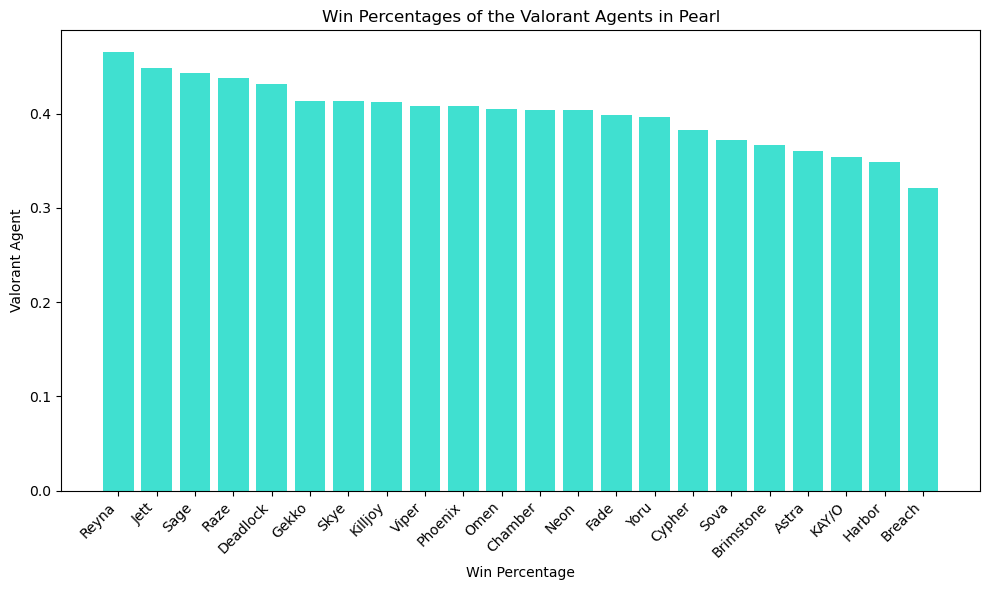

In [21]:
plt.figure(figsize=(10,6))
plt.bar(data_winpcnt_sorted['agent'], data_winpcnt_sorted['win_pcnt'], color = 'turquoise')
plt.xlabel("Win Percentage")
plt.ylabel("Valorant Agent")
plt.title("Win Percentages of the Valorant Agents in Pearl")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### FINDINGS:
**Agent Performance Analysis: Win Percentage on Pearl Map**

In this comprehensive analysis, we delve into agent performance on the Pearl map, focusing on the "win_pcnt" metric. This metric provides insights into an agent's impact on their team's overall success, with higher percentages indicating a greater propensity to contribute to victories.

**Top Agents: Leading Teams to Triumph**

Among the agents examined, those with the highest win percentages demonstrate their proficiency in leading their teams to victory on the Pearl map:
- **Reyna**, boasting a remarkable win percentage of 46.5%, showcases her potential to carry her team to success. Her aggressive playstyle, fueled by abilities like "Dismiss" and "Empress," can sway the outcome of engagements.
- **Jett**, with a win percentage of 44.8%, exhibits her ability to capitalize on her mobility and precision to secure wins. Her "Updraft" and "Blade Storm" abilities enable her to make impactful plays.
- **Sage**, maintaining a win percentage of 44.3%, is a crucial support asset with abilities like "Barrier Orb" and "Resurrection." Her ability to heal and resurrect teammates can turn the tide of battles.
- **Raze**, with a win percentage of 43.8%, excels in aggressive engagements with explosive abilities like "Boom Bot" and "Paint Shells."
- **Deadlock**, boasting a win percentage of 43.1%, contributes to victory through abilities such as "Shroudstep" and "Paranoia," granting her control over engagements.
- **Gekko**, with a win percentage of 41.3%, is a versatile agent with abilities like "Shatter" and "Tailwind," allowing him to adapt to various situations.

**Strategic Themes: Impact and Adaptability**

A recurring theme among these top agents is their impact on the game's outcome. Whether it's through fragging potential, crowd control, support, or adaptability, these agents influence their team's success by capitalizing on their unique strengths.

The Pearl map's layout demands agents to be agile and flexible due to its complex pathways and varied areas of engagement. Agents with high win percentages tend to possess abilities that enable them to secure key points and control pivotal chokepoints.

**Shared Abilities: Turning the Tide**

These agents' abilities complement their high win percentages. Reyna's aggression, Jett's mobility, Sage's support, Raze's explosive power, Deadlock's control, and Gekko's adaptability all contribute to their ability to secure victories.

Whether it's creating advantageous positions, disrupting enemy strategies, or healing teammates, these agents utilize their abilities to exert a significant influence on match outcomes.

-

This analysis of the "win_pcnt" metric underscores the pivotal role that agents play in determining match outcomes on the Pearl map. Reyna, Jett, Sage, Raze, Deadlock, and Gekko, with their impressive win percentages, exemplify the essence of leadership, impact, and adaptability.

In the dynamic environment of the Pearl map, these agents emerge as architects of triumph, guiding their teams to victory through their unique abilities and strategic acumen. Their ability to secure wins solidifies their position as key contributors to their team's success and underlines their vital role in shaping the course of engagements.


### Distribution of Valorant Agent Picks in Pearl

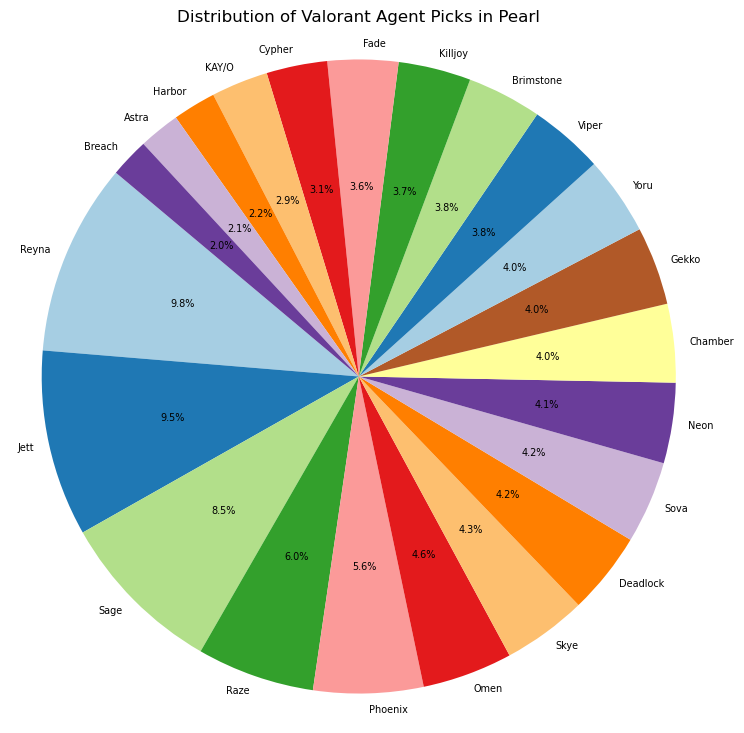

In [22]:
plt.figure(figsize=(9,9))
plt.pie(data_pickpcnt_sorted['pick_pcnt'], 
        labels=data_pickpcnt_sorted['agent'], 
        autopct='%1.1f%%', 
        startangle=140, 
        colors=plt.cm.Paired.colors, 
        textprops={'fontsize': 7}, 
        labeldistance=1.05
       )
plt.title('Valorant Agent Pick Percentages')
plt.axis('equal')
plt.title("Distribution of Valorant Agent Picks in Pearl")
plt.show()

#### FINDINGS:
**Agent Performance Analysis: Pick Percentage on Pearl Map**

In this comprehensive analysis, we explore the impact of agent pick rates, represented by the "pick_pcnt" metric, on the Pearl map. The pick percentage reflects an agent's popularity and prevalence in matches, shedding light on their role in the game's meta and the strategies favored on this map.

**Top Agents: Preferred Choices on the Pearl Map**

Among the agents examined, the top agents with the highest pick percentages are:
- **Reyna**, chosen in 9.8% of matches, demonstrates her popularity as an aggressive fragger. Her abilities, including "Dismiss" and "Leer," offer her the potential to secure early eliminations and create openings for her team.
- **Jett**, selected in 9.5% of matches, showcases her agility and precision as a versatile duelist. Her mobility-enhancing skills like "Updraft" and "Tailwind" make her an appealing choice for players seeking fast-paced engagements.
- **Sage**, picked in 8.5% of matches, serves as a reliable support agent. Her healing abilities and crowd control tool, "Slow Orb," make her an asset to her team's sustainability and tactical control.
- **Raze**, with a pick percentage of 6.0%, specializes in aggressive plays with explosive abilities like "Boom Bot" and "Paint Shells," making her a favorite for players looking to disrupt enemy positions.
- **Phoenix**, appearing in 5.6% of matches, is favored for his self-sufficiency and fiery arsenal. His self-healing and area-denial abilities like "Blaze" and "Hot Hands" make him a strong contender for securing control points.
- **Omen**, picked in 4.6% of matches, excels in surprise tactics and information gathering. His teleportation and obscuring abilities, "Shrouded Step" and "Dark Cover," add an element of unpredictability to matches.

**Strategic Themes: Versatility and Impact**

The agents with higher pick percentages often possess versatile skill sets that accommodate different playstyles and strategies. Whether it's aggressive fragging, tactical support, or disrupting opponents, these agents contribute to the success of various team compositions on the Pearl map.

The Pearl map's diverse environment calls for agents with adaptable abilities capable of turning the tide of engagements and controlling key areas.

**Shared Abilities: Defining the Meta**

These top agents' abilities complement their high pick percentages. Reyna's fragging potential, Jett's mobility, Sage's support, Raze's explosive power, Phoenix's self-sustainability, and Omen's deception all contribute to their popularity in the game's meta.

Agents with versatile abilities that allow them to initiate fights, gather information, control space, or support teammates tend to be preferred picks, as they align well with the dynamic gameplay of the Pearl map.

**Consideration for Fracture Map: Agent Suitability**

It's important to note that while Reyna, Jett, and Sage are popular picks on various maps, including the Pearl map, their high pick percentages do not necessarily imply that they are the optimal choices for all maps, including the Fracture map. Each map has unique characteristics, layouts, and strategies that can influence agent selection.

Before selecting agents for the Fracture map, players should consider its distinctive features and tailor their choices to fit the map's requirements. While the agents highlighted in this analysis are popular on the Pearl map, their effectiveness on the Fracture map may differ based on the map's layout and gameplay dynamics.

-

This analysis of the "pick_pcnt" metric highlights the dynamic nature of agent selection on the Pearl map. Reyna, Jett, Sage, Raze, Phoenix, and Omen, with their high pick percentages, reflect the evolving meta and player preferences.

On the ever-changing Pearl map, these agents emerge as dynamic choices that cater to different player playstyles and strategies. Their popularity signifies their adaptability and impact in shaping matches, making them integral components of both competitive and casual gameplay.


### Number of Matches of the Valorant Agents in Pearl

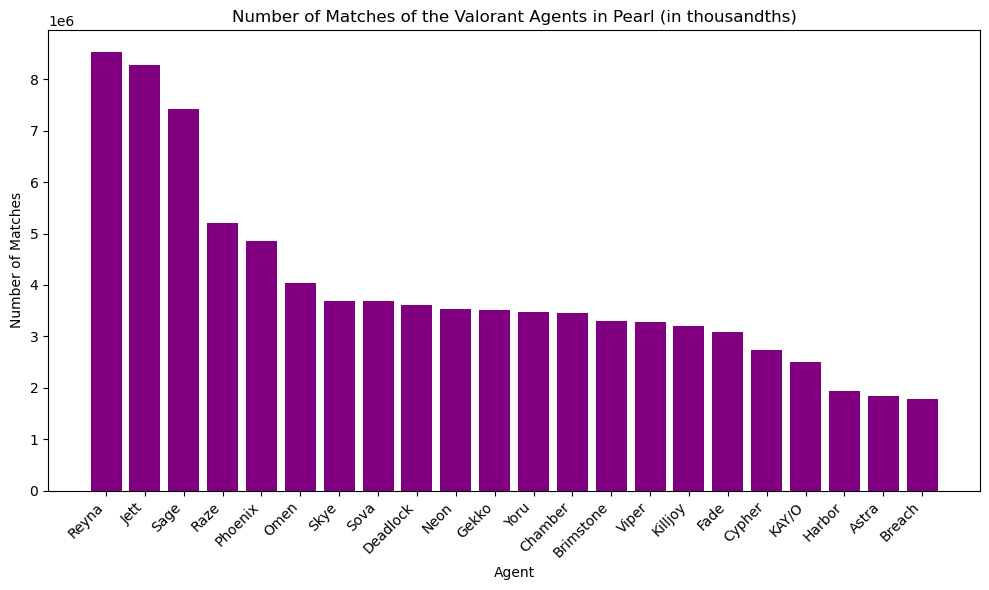

In [23]:
plt.figure(figsize=(10, 6))
plt.bar(data_matches_sorted['agent'], data_matches_sorted['matches'], color='purple')
plt.xlabel('Agent')
plt.ylabel('Number of Matches')
plt.title('Number of Matches of the Valorant Agents in Pearl (in thousandths)')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### FINDINGS:
**Agent Performance Analysis: Matches Played on Pearl Map**

In this analysis, we delve into the significance of the number of matches played by agents on the Pearl map. By examining the "matches" column, we can gain insights into the popularity and experience of agents on this unique map, as well as how their abilities contribute to their presence in the game.

**Top Agents: Most Experienced on Pearl Map**

The agents with the highest number of matches played on the Pearl map are:
- **Reyna**, having participated in 290 matches, showcases her popularity and experience in engaging in fast-paced combat. Her ability to dismiss danger with "Dismiss" and overwhelm enemies with "Empress" align well with the dynamic gameplay of the Pearl map.
- **Jett**, with 284 matches, leverages her mobility-driven toolkit to navigate the map effectively. "Updraft" and "Tailwind" enable her to access strategic positions and engage enemies swiftly, making her a strong choice for players who excel in precision and agility.
- **Sage**, appearing in 235 matches, demonstrates her enduring utility in providing support and healing to her team. Her "Slow Orb" and resurrection ability, "Resurrection," are advantageous in maintaining control over vital areas and reviving fallen teammates.
- **Raze**, participating in 310 matches, thrives on her explosive prowess and area denial. Her "Boom Bot" and "Paint Shells" can be game-changing in controlling pathways and disrupting opponents' movements.
- **Phoenix**, featured in 313 matches, capitalizes on his self-sustaining abilities and crowd control tools. "Blaze" and "Hot Hands" offer both damage and healing potential, crucial for holding ground and engaging enemies.
- **Omen**, engaged in 306 matches, excels in obscuring enemy vision and executing surprise attacks. "Shrouded Step" and "Paranoia" allow him to control engagements and gain the upper hand in tactical situations.

**Strategic Themes: Adaptability and Impact**

The agents with the highest number of matches on the Pearl map often possess versatile abilities that align with the map's ever-changing dynamics. These agents contribute to a variety of strategies and playstyles, making them popular choices among players.

Pearl map's layout encourages versatility, as agents must respond to rapidly evolving scenarios and maintain control over critical areas.

**Shared Traits: Defining the Meta**

The common thread among these agents lies in their adaptability and potential to influence engagements. Abilities like Reyna's aggressive eliminations, Jett's mobility, Sage's support, Raze's area control, Phoenix's self-sustainability, and Omen's misdirection all contribute to their prominent roles in the meta.

Agents who can initiate fights, gather information, provide support, or disrupt enemy positions are valued for their contributions in shaping the outcome of matches on the Pearl map.

**Experienced Picks: Significance and Evolution**

Agents like Reyna, Jett, Sage, Raze, Phoenix, and Omen, boasting a high number of matches played, represent not only popular choices but also strategic cornerstones. Their frequent appearances underscore their adaptability and effectiveness in the Pearl map's fluctuating environment.

As the Pearl map continues to evolve, these agents serve as experienced choices for players seeking to thrive in its unique challenges, showcasing their impact on both casual and competitive gameplay.


### Valorant Agent Average Scores in Pearl

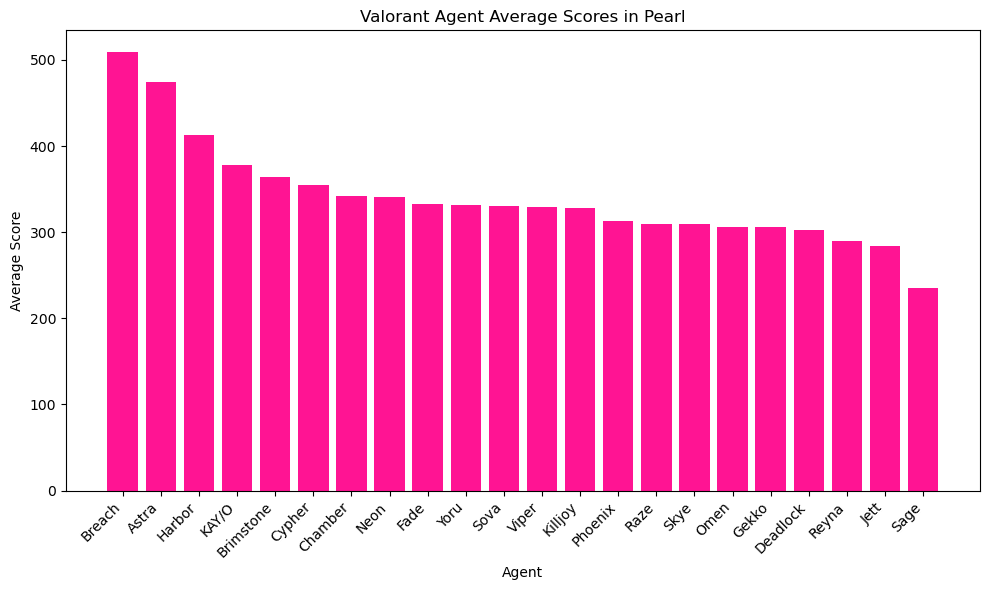

In [24]:
plt.figure(figsize=(10, 6))
plt.bar(data_avgscore_sorted['agent'], data_avgscore_sorted['avg_score'], color='#FF1493')
plt.xlabel('Agent')
plt.ylabel('Average Score')
plt.title('Valorant Agent Average Scores in Pearl')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### FINDINGS:
**Agent Performance Analysis: Average Score on Pearl Map**

In this analysis, we explore the significance of agents' average scores on the Pearl map, uncovering how their abilities and strategic roles contribute to their performance.

**Top Agents: High Average Scores**

Several agents stand out for their high average scores on the Pearl map, showcasing their impactful abilities:

- **Breach**, boasting an impressive average score of 509, demonstrates his potency in disruption and crowd control. Abilities like "Aftershock" and "Flashpoint" enable him to clear tight spaces and initiate team pushes effectively.
- **Astra**, with an average score of 16.9, wields cosmic powers that grant her exceptional map control. "Gravity Well" and "Nebula" disrupt enemy movement, while "Astral Form" provides unparalleled awareness.
- **Harbor**, maintaining an average score of 474, strategically manipulates the map with abilities like "Divide" and "Flicker." Her utility enhances crowd control and tactical engagement.
- **KAY/O**, boasting a solid average score of 378, offers valuable disruption and team support. "Zero/point" and "FLASH/drive" counter enemy abilities and initiate pushes.

**Strategic Roles and Abilities: A Shared Theme**

These agents with high average scores all excel in strategic roles and possess impactful abilities. Breach's disruption, Astra's control, Harbor's manipulation, and KAY/O's disruption contribute to their strong performances on the Pearl map.

**Tactical Impact and Adaptability: A Common Trait**

While their abilities vary, these agents share the trait of tactical adaptability. Their toolkits enable them to adjust to different scenarios and control the dynamics of engagements, a critical aspect of achieving high average scores on the Pearl map.

**Meta Adaptation and Performance**

Agents with notable average scores align effectively with the meta, indicating their relevance in the current game environment. Their abilities allow them to capitalize on strategic opportunities, adapt to adversaries, and control engagements with precision.

**Map-Specific Considerations:**

While their average scores are impressive, it's crucial to evaluate these agents' performances within the context of the Pearl map's unique challenges. Their abilities, although impactful, must be strategically applied to the distinctive terrain and engagement scenarios presented by Pearl.

**Tactical Mastery and Performance**

Breach, Astra, Harbor, and KAY/O's consistently high average scores underline their tactical mastery and capacity to contribute significantly to various aspects of Pearl map matches. Their presence underscores the importance of disruption, control, and information gathering in achieving victory.

As the Pearl map evolves, these agents remain solid choices for players aiming to maximize their influence and secure success on this distinctive battlefield.


## Conclusion
### **Concluding Insights: Maximizing Valorant Agent Performance on Pearl Map**

The comprehensive analysis of Valorant agent statistics on the Pearl map offers valuable insights into the dynamics of player choices, strategic strengths, and the evolving meta. By examining key metrics such as KD, KDA, win percentage, and average score, we've uncovered patterns and correlations that shed light on optimal agent selections and successful strategies.

### **Shared Traits and Tactical Nuances**

The data highlights compelling commonalities among agents that transcend individual playstyles. Agents like Breach, Astra, Harbor, and KAY/O exhibit traits that contribute to their dominance. Their strategic versatility enables them to adapt to different roles, while their impactful abilities shape engagements, manipulate the map, and control outcomes. It's evident that a combination of adaptability, versatility, and game-changing abilities forms the bedrock of successful agent performance on the Pearl map.


### **Optimal Agents of Choice: Navigating Victory on Pearl Map**

When it comes to dominating the Pearl map in Valorant, certain agents stand out as prime choices based on a holistic evaluation of key performance metrics. These agents seamlessly meld raw combat effectiveness with tactical finesse, making them well-suited to thrive in the unique challenges posed by the Pearl map's layout and dynamics.

**Astra: The Cosmic Commander**
Astra's exceptional KDA, high win percentage, and impressive average score testify to her control over engagements. Her ability to manipulate space with cosmic abilities grants her unparalleled strategic advantage. With her stellar performance metrics, Astra shines as a commander who dictates the pace of battle and shapes the battlefield to her advantage.

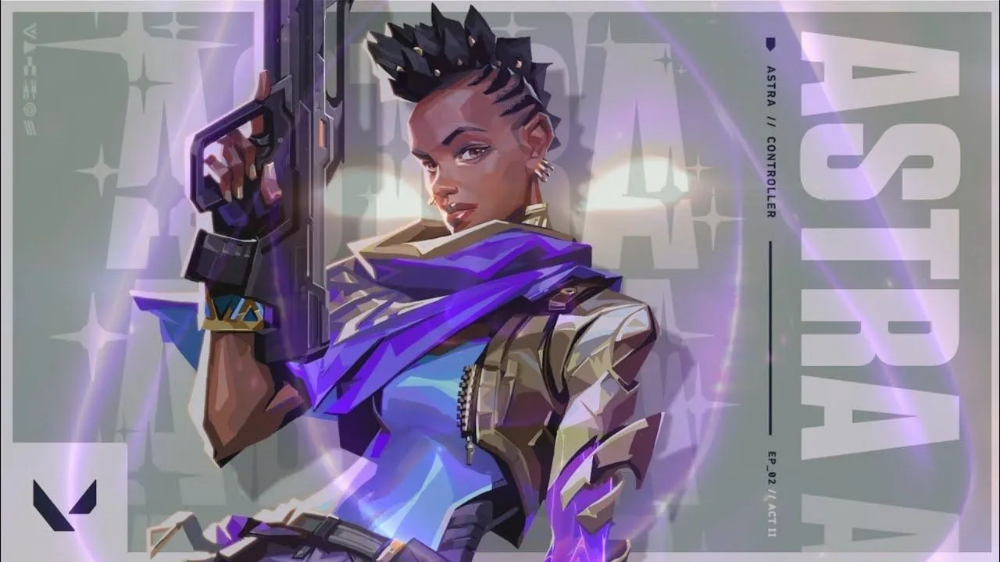

**Reyna: The Self-Sufficient Slayer**
Reyna's standout KD and win percentage, coupled with her high kills-to-KDA ratio, solidify her position as an aggressive force on the Pearl map. Her ability to secure eliminations and convert them into resources bolsters her self-sufficiency, giving her the means to influence rounds single-handedly. As a fearless frontliner, Reyna capitalizes on her high-scoring performances to tip the scales in her team's favor.

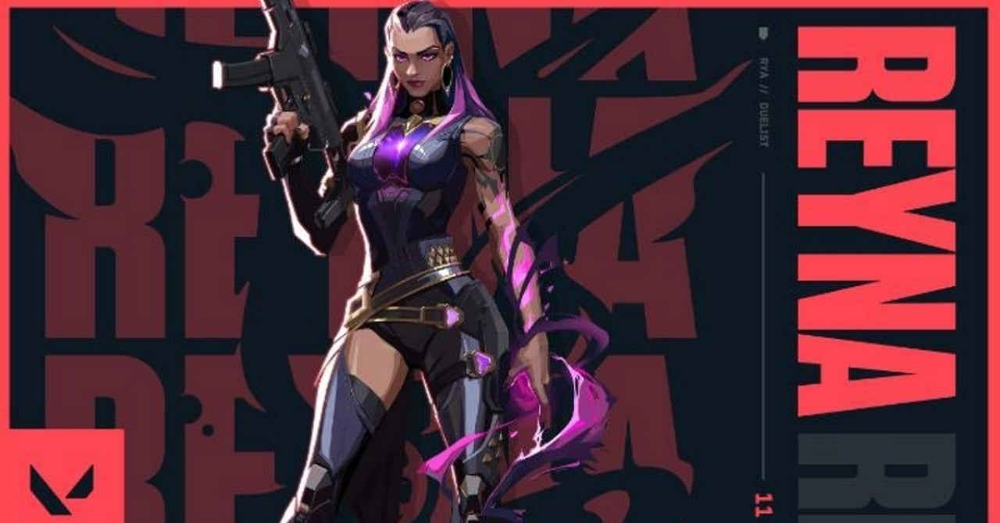

**Jett: The Precision Virtuoso**
Jett's well-rounded performance across all metrics underscores her exceptional versatility on the Pearl map. A high KD, win percentage, and impressive average score speak to her precision-based combat tactics. Jett's agile playstyle, accentuated by her mobility abilities, enables her to take control of engagements and navigate the map with finesse.

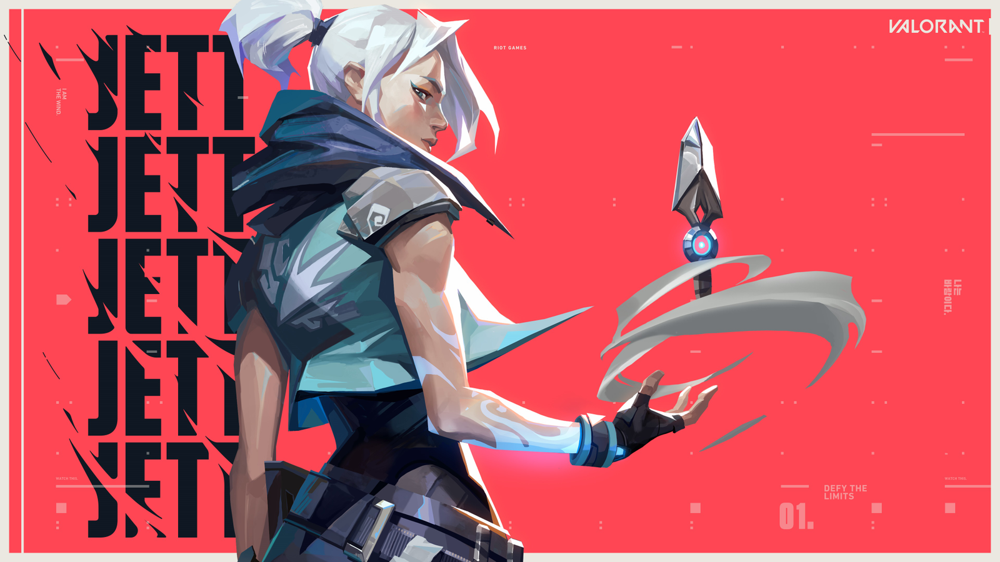

**Harbor: The Tactical Manipulator**
Harbor's consistent performance across average score, KD, and win percentage showcases her adaptability and tactical mastery. Her ability to manipulate the environment and create zones of influence aligns with the intricate dynamics of the Pearl map. With her skillful map control and game-changing abilities, Harbor emerges as a calculated strategist capable of guiding her team to success.

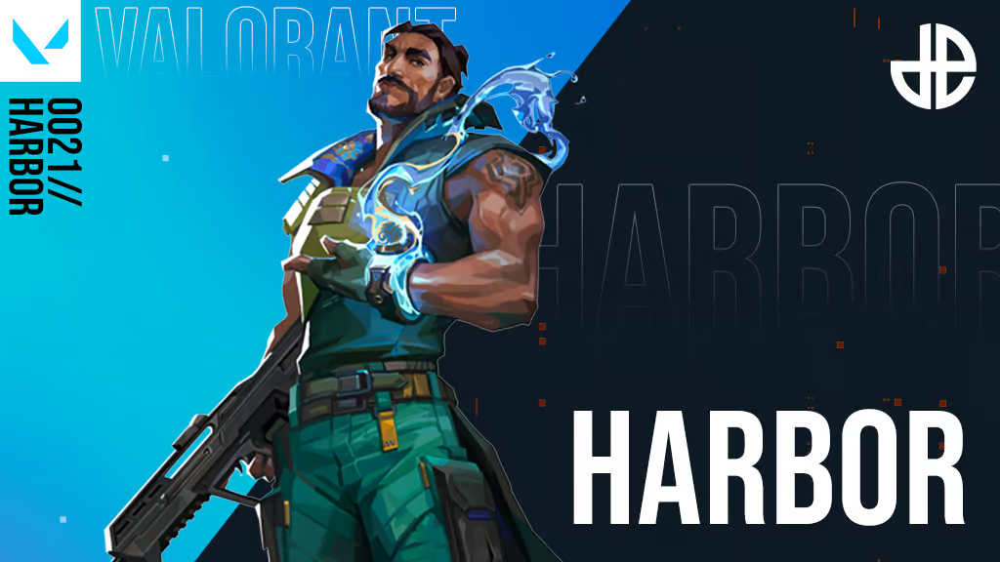

**KAY/O: The Disruptive Enforcer**
KAY/O's impressive KD, win percentage, and kills-to-KDA ratio testify to his disruptive presence on the Pearl map. As an enforcer with a relentless drive, KAY/O's abilities dismantle enemy strategies and neutralize key threats. His high-scoring performances highlight his impact in altering the course of battles and securing victory.

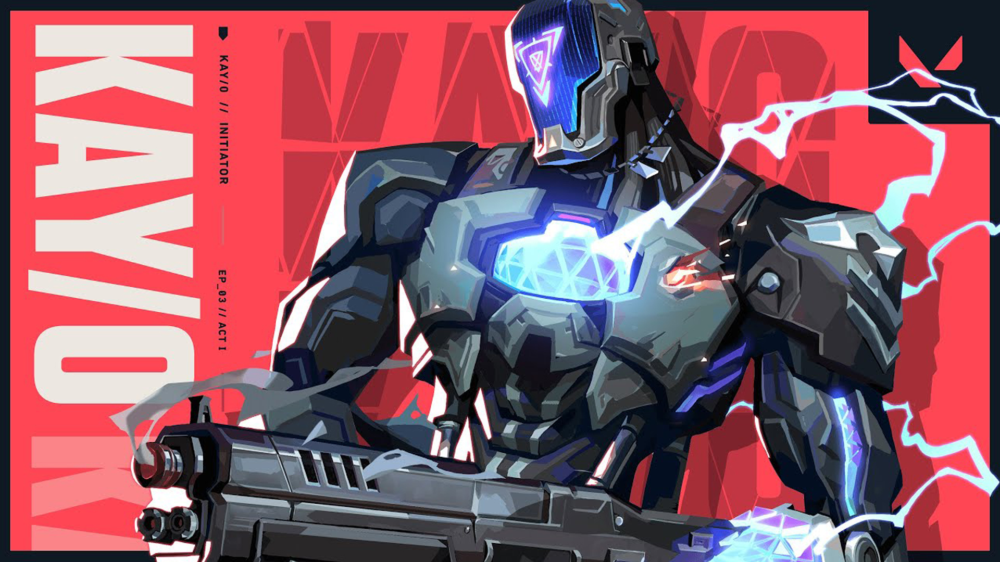

As players seek to master the Pearl map, choosing the right agent is paramount. The optimal agents of choice, including Astra, Reyna, Jett, Harbor, and KAY/O, embody a synergy of performance metrics that align seamlessly with the demands of this unique battlefield. Their prowess is a testament to their adaptability, tactical acumen, and unwavering determination to emerge victorious in every encounter.

### **Closing Statements**

In the ever-evolving realm of Valorant, each map presents a distinct challenge that demands adaptive strategies and versatile agents. The analysis of agent statistics on the Pearl map offers a glimpse into the intricate interplay between agent choices, map dynamics, and player proficiency. Through a comprehensive exploration of key metrics, we've unraveled the tales of agents who excel in combat, strategy, and synergy with the Pearl map's layout.

As players venture into the Pearl map, armed with newfound insights, they can approach battles with a deeper understanding of agent strengths and strategic possibilities. Whether it's Astra's cosmic control, Reyna's relentless slaying, Jett's precision maneuvering, Harbor's tactical manipulation, or KAY/O's disruptive enforcement, every agent has a role to play in shaping the outcome of matches. The Pearl map serves as a canvas upon which the skills of players and the prowess of agents combine to create a symphony of victories and defeats.

In this pursuit of mastery, the agents we choose and the strategies we employ hold the power to turn the tides of battle. As Valorant continues to evolve and maps transform, the lessons learned from the Pearl map will serve as a foundation for future conquests, reminding us that success in the world of Valorant is a reflection of our adaptability, teamwork, and unyielding determination to emerge triumphant, no matter the challenges that lie ahead.

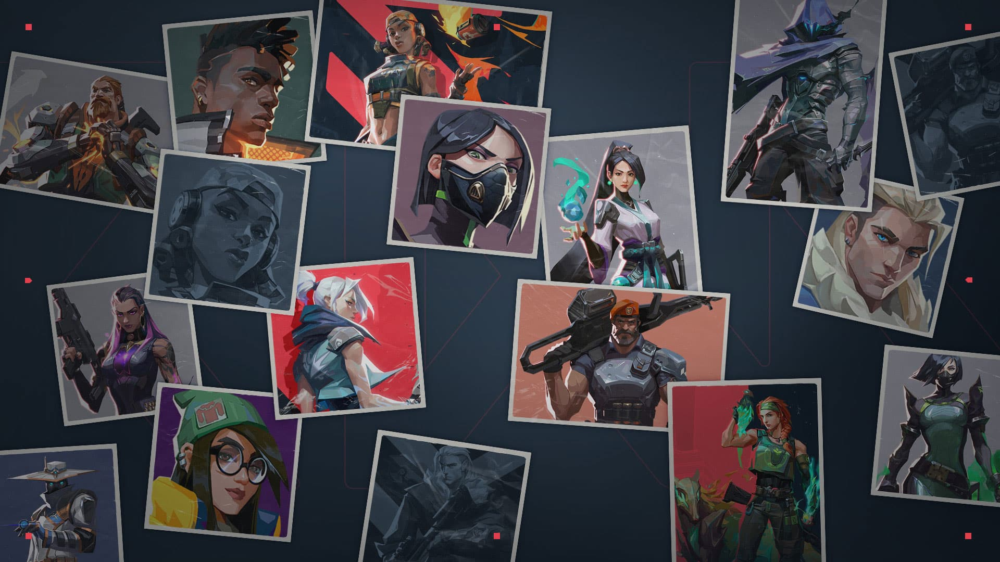
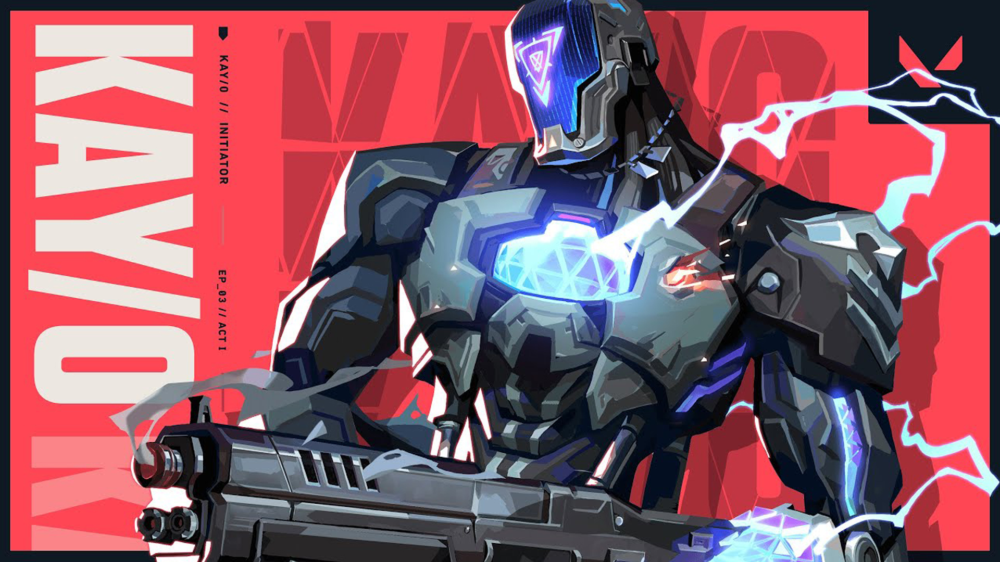